In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn import svm

In [3]:
!pip install catboost
from catboost import Pool,CatBoostClassifier

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 76.8 MB 1.1 MB/s 


In [4]:
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Activation, Reshape
from keras.layers import LSTM
from keras.layers import Bidirectional

In [5]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [1057]:
df_train = pd.read_excel("/content/dataset_train.xlsx")

In [1058]:
df_train.head()

,Obfuscated name,Test_index,Presentation,Question,Data,Class_label_FPG
0,c6c1c29d-0331-46e7-966b-808d34cca6ee,3,2,10,"[-24, 51, 75, 51, 14, -13, -25, -45, -77, -76,...",1
1,0fbd87a7-f107-4e0f-aef2-a14ecfe658e6,2,1,11,"[-305, -320, -278, -267, -308, -375, -467, -53...",1
2,23a36ef6-45be-4ed9-9c4d-0169283054b5,2,2,6,"[60, 37, 39, 69, 60, 30, -7, -37, -60, -71, -8...",1
3,c5ba273c-c85e-4ab0-94a8-647f4589989d,1,3,7,"[65, 48, 30, 18, 9, 0, -18, -35, -1, 83, 119, ...",1
4,c291a7ab-817d-497d-8cfe-86df504a665f,4,1,4,"[116, 95, 80, 78, 78, 73, 63, 47, 45, 94, 119,...",1


In [1059]:

df_train[df_train['Obfuscated name'] == '001945e6-1756-4745-bd86-c016f6ba6e6b']


,Obfuscated name,Test_index,Presentation,Question,Data,Class_label_FPG
127,001945e6-1756-4745-bd86-c016f6ba6e6b,3,3,11,"[733, 665, 596, 492, 367, 241, 147, 63, -18, -...",2
247,001945e6-1756-4745-bd86-c016f6ba6e6b,2,2,12,"[919, 897, 901, 953, 1045, 1135, 1210, 1325, 1...",1
303,001945e6-1756-4745-bd86-c016f6ba6e6b,2,3,9,"[237, 221, 197, 135, 38, -63, -144, -211, -271...",1
481,001945e6-1756-4745-bd86-c016f6ba6e6b,3,2,12,"[-116, -173, -126, 204, 421, 511, 503, 442, 39...",2
551,001945e6-1756-4745-bd86-c016f6ba6e6b,3,3,6,"[-52, -156, -245, -342, -424, -436, -45, 493, ...",2
840,001945e6-1756-4745-bd86-c016f6ba6e6b,3,2,1,"[52, -52, 18, 283, 618, 788, 807, 724, 609, 53...",2
1020,001945e6-1756-4745-bd86-c016f6ba6e6b,2,2,4,"[62, -55, -183, -264, -249, -33, 243, 422, 489...",1
1557,001945e6-1756-4745-bd86-c016f6ba6e6b,3,2,11,"[1508, 1608, 1572, 1468, 1386, 1293, 1119, 985...",1
1795,001945e6-1756-4745-bd86-c016f6ba6e6b,2,3,2,"[174, 92, 68, 221, 505, 823, 872, 810, 738, 67...",2
1880,001945e6-1756-4745-bd86-c016f6ba6e6b,3,2,10,"[-742, -869, -935, -997, -1078, -1146, -916, -...",1


In [1060]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28713 entries, 0 to 28712
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Obfuscated name  28713 non-null  object
 1   Test_index       28713 non-null  int64 
 2   Presentation     28713 non-null  int64 
 3   Question         28713 non-null  int64 
 4   Data             28713 non-null  object
 5   Class_label_FPG  28713 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 1.3+ MB


In [1163]:
df_train['Class_label_FPG'].value_counts()

1    14205
2     8268
0     6240
Name: Class_label_FPG, dtype: int64

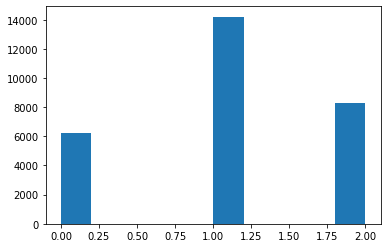

In [1061]:
plt.hist(df_train['Class_label_FPG'])
plt.show()

In [1062]:
df_train['Data'] = df_train['Data'].str.replace('[', '')
df_train['Data'] = df_train['Data'].str.replace(']', '')
df_train['Data'] = df_train['Data'].str.replace(',', '')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  


In [1063]:
Data_new = []
for d in df_train['Data']:
  Data_new.append(list(map(int, d.split())))

In [1064]:
df_train['Data'] = Data_new

In [1065]:
np.median([[0,1,1,2],[9,9,9,9]])

5.5

In [1066]:
df_train_new = {'Obfuscated name': [], 'Test_index': [], 'Presentation': [], 'Question': [], 'Data': [],
                'Class_label_FPG': [], 'Min_Data_all': [], 'Max_Data_all': [], 'Std_Data_all': [], 'Mean_Data_all': [], 'Med_Data_all': [], 'Q25_Data_all': [], 'Q75_Data_all': []}
df_train_new = pd.DataFrame(df_train_new)

In [1067]:
for name in set(df_train['Obfuscated name'].tolist()):
  for test in set(df_train[df_train['Obfuscated name'] == name]['Test_index'].tolist()):
    for pres in set(df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test]['Presentation'].tolist()):
      D = []

      for q in set(df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres]['Question'].tolist()):
        data = df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres][df_train['Question'] == q]['Data']
        D = [*D,*data]
      D = np.array(D)
      D = D.reshape(1,D.shape[0]*D.shape[1])
      Min_Data = np.min(D)
      Max_Data = np.max(D)
      Std_Data = np.std(D)
      Mean_Data = np.mean(D)
      Med_Data = np.median(D)
      Q25_Data = np.quantile(D,0.25)
      Q75_Data = np.quantile(D,0.75)
      for q in set(df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres]['Question'].tolist()):
        Data_ = df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres][df_train['Question'] == q]['Data'].to_numpy()
        C  = df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres][df_train['Question'] == q]['Class_label_FPG'].to_numpy()
        df_train_new =df_train_new.append({'Obfuscated name': name, 'Test_index': test, 'Presentation': pres, 'Question': q, 'Data': Data_,
          'Class_label_FPG':int(C), 'Min_Data_all': Min_Data, 'Max_Data_all': Max_Data, 'Std_Data_all': Std_Data, 'Mean_Data_all': Mean_Data,
          'Med_Data_all': Med_Data, 'Q25_Data_all': Q25_Data, 'Q75_Data_all': Q75_Data}, ignore_index=True)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [1068]:
df_train_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28713 entries, 0 to 28712
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Obfuscated name  28713 non-null  object 
 1   Test_index       28713 non-null  float64
 2   Presentation     28713 non-null  float64
 3   Question         28713 non-null  float64
 4   Data             28713 non-null  object 
 5   Class_label_FPG  28713 non-null  float64
 6   Min_Data_all     28713 non-null  float64
 7   Max_Data_all     28713 non-null  float64
 8   Std_Data_all     28713 non-null  float64
 9   Mean_Data_all    28713 non-null  float64
 10  Med_Data_all     28713 non-null  float64
 11  Q25_Data_all     28713 non-null  float64
 12  Q75_Data_all     28713 non-null  float64
dtypes: float64(11), object(2)
memory usage: 2.8+ MB


In [1069]:
df_train_new.head()

,Obfuscated name,Test_index,Presentation,Question,Data,Class_label_FPG,Min_Data_all,Max_Data_all,Std_Data_all,Mean_Data_all,Med_Data_all,Q25_Data_all,Q75_Data_all
0,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1.0,1.0,"[[-61, -52, -56, -66, -74, -80, -84, -90, -99,...",1.0,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0
1,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1.0,2.0,"[[-52, -54, -23, 20, 37, 35, 26, 18, 15, 11, 5...",1.0,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0
2,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1.0,3.0,"[[8, -4, -12, -18, 11, 46, 53, 45, 34, 28, 24,...",2.0,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0
3,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1.0,4.0,"[[-17, -28, -39, -49, -58, -28, 8, 18, 13, -2,...",1.0,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0
4,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1.0,5.0,"[[14, -1, -13, -25, -33, -35, -9, 33, 49, 31, ...",0.0,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0


In [1070]:
Min_Data = []
Max_Data = []
Std_Data = []
Mean_Data = []
Med_Data = []
Q25_Data = []
Q75_Data = []
for i in df_train_new['Data']:
  Min_Data.append(np.min(list(i)))
  Max_Data.append(np.max(list(i)))
  Std_Data.append(np.std(list(i)))
  Mean_Data.append(np.mean(list(i)))
  Med_Data.append(np.median(list(i)))
  Q25_Data.append(np.quantile(list(i),0.25))
  Q75_Data.append(np.quantile(list(i),0.75))




In [1071]:
df_train_new['Min_Data'] = Min_Data
df_train_new['Max_Data'] = Max_Data
df_train_new['Std_Data'] = Std_Data
df_train_new['Mean_Data'] = Mean_Data
df_train_new['Med_Data'] = Med_Data
df_train_new['Q25_Data'] = Q75_Data
df_train_new['Q75_Data'] = Q75_Data

In [1102]:
df_train_new['Class_label_FPG'] = df_train_new['Class_label_FPG'].astype(int)
df_train_new['Presentation'] = df_train_new['Presentation'].astype(int)
df_train_new['Question'] = df_train_new['Question'].astype(int)

In [1114]:
data = []
for i in df_train_new['Data']:
  data.append(list(i)[0])

In [1117]:
df_train_new['Data'] = data

In [1118]:
df_train_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28713 entries, 0 to 28712
Data columns (total 20 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Obfuscated name  28713 non-null  object 
 1   Test_index       28713 non-null  float64
 2   Presentation     28713 non-null  int64  
 3   Question         28713 non-null  int64  
 4   Data             28713 non-null  object 
 5   Class_label_FPG  28713 non-null  int64  
 6   Min_Data_all     28713 non-null  float64
 7   Max_Data_all     28713 non-null  float64
 8   Std_Data_all     28713 non-null  float64
 9   Mean_Data_all    28713 non-null  float64
 10  Med_Data_all     28713 non-null  float64
 11  Q25_Data_all     28713 non-null  float64
 12  Q75_Data_all     28713 non-null  float64
 13  Min_Data         28713 non-null  int64  
 14  Max_Data         28713 non-null  int64  
 15  Std_Data         28713 non-null  float64
 16  Mean_Data        28713 non-null  float64
 17  Med_Data    

In [1119]:
df_train_new.head()

,Obfuscated name,Test_index,Presentation,Question,Data,Class_label_FPG,Min_Data_all,Max_Data_all,Std_Data_all,Mean_Data_all,Med_Data_all,Q25_Data_all,Q75_Data_all,Min_Data,Max_Data,Std_Data,Mean_Data,Med_Data,Q25_Data,Q75_Data
0,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1,1,"[-61, -52, -56, -66, -74, -80, -84, -90, -99, ...",1,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0,-122,43,36.991941,-34.354167,-30.5,-5.00,-5.00
1,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1,2,"[-52, -54, -23, 20, 37, 35, 26, 18, 15, 11, 5,...",1,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0,-97,192,71.860281,15.504167,5.5,61.00,61.00
2,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1,3,"[8, -4, -12, -18, 11, 46, 53, 45, 34, 28, 24, ...",2,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0,-120,106,59.853849,-7.408333,-11.5,44.00,44.00
3,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1,4,"[-17, -28, -39, -49, -58, -28, 8, 18, 13, -2, ...",1,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0,-87,91,41.560244,-9.233333,-12.5,18.25,18.25
4,4576fa68-dd00-4e2b-bb70-c1e54b6f9199,1.0,1,5,"[14, -1, -13, -25, -33, -35, -9, 33, 49, 31, 1...",0,-122.0,192.0,46.007854,-6.758333,-10.0,-39.0,20.0,-75,51,29.229190,-9.433333,-10.0,11.25,11.25


In [1180]:
df_train_new.to_csv('df_train_new.csv', index=False)

In [1074]:
X = df_train_new.drop(['Obfuscated name','Test_index','Presentation', 'Question', 'Class_label_FPG', 'Data'], axis = 1)
y = df_train_new['Class_label_FPG']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
#X_test, X_val, y_test, y_val = train_test_split(X_test, y_test,train_size=0.5, random_state=42, stratify=y_test)

In [1082]:
rbf = svm.SVC(kernel='rbf')
poly = svm.SVC(kernel='poly')
clf = svm.SVC(decision_function_shape='ovo')

In [1083]:
W = {'0': 1.75, '1': 1, '2': 1.25}

In [1087]:
rbf.fit(X_train,y_train)
poly.fit(X_train,y_train)

SVC(decision_function_shape='ovo')

In [1088]:
poly_pred = poly.predict(X_test)
rbf_pred = rbf.predict(X_test)

In [1089]:
poly_accuracy = accuracy_score(y_test, poly_pred)
poly_f1 = f1_score(y_test, poly_pred, average='weighted')
print('Accuracy (Polynomial Kernel): ', "%.2f" % (poly_accuracy*100))
print('F1 (Polynomial Kernel): ', "%.2f" % (poly_f1*100))

Accuracy (Polynomial Kernel):  50.44
F1 (Polynomial Kernel):  35.97


In [1090]:
rbf_accuracy = accuracy_score(y_test, rbf_pred)
rbf_f1 = f1_score(y_test, rbf_pred, average='weighted')
print('Accuracy (RBF Kernel): ', "%.2f" % (rbf_accuracy*100))
print('F1 (RBF Kernel): ', "%.2f" % (rbf_f1*100))

Accuracy (RBF Kernel):  52.52
F1 (RBF Kernel):  41.19


In [1092]:
Max_Error = 0
for i in y_test:
  if (i == 0):
    i = 2
  Max_Error+=i

In [1096]:
print('rbf score:',1 - (np.abs(np.array(rbf_pred)-np.array(y_test)).sum() / Max_Error))
print('poly score:',1 - (np.abs(np.array(poly_pred)-np.array(y_test)).sum() / Max_Error))

rbf score: 0.6831694621168305
poly score: 0.670213996529786
poly score: 0.6831694621168305


------------------

In [8]:
df_train_new = pd.read_csv("/content/df_train_new.csv")

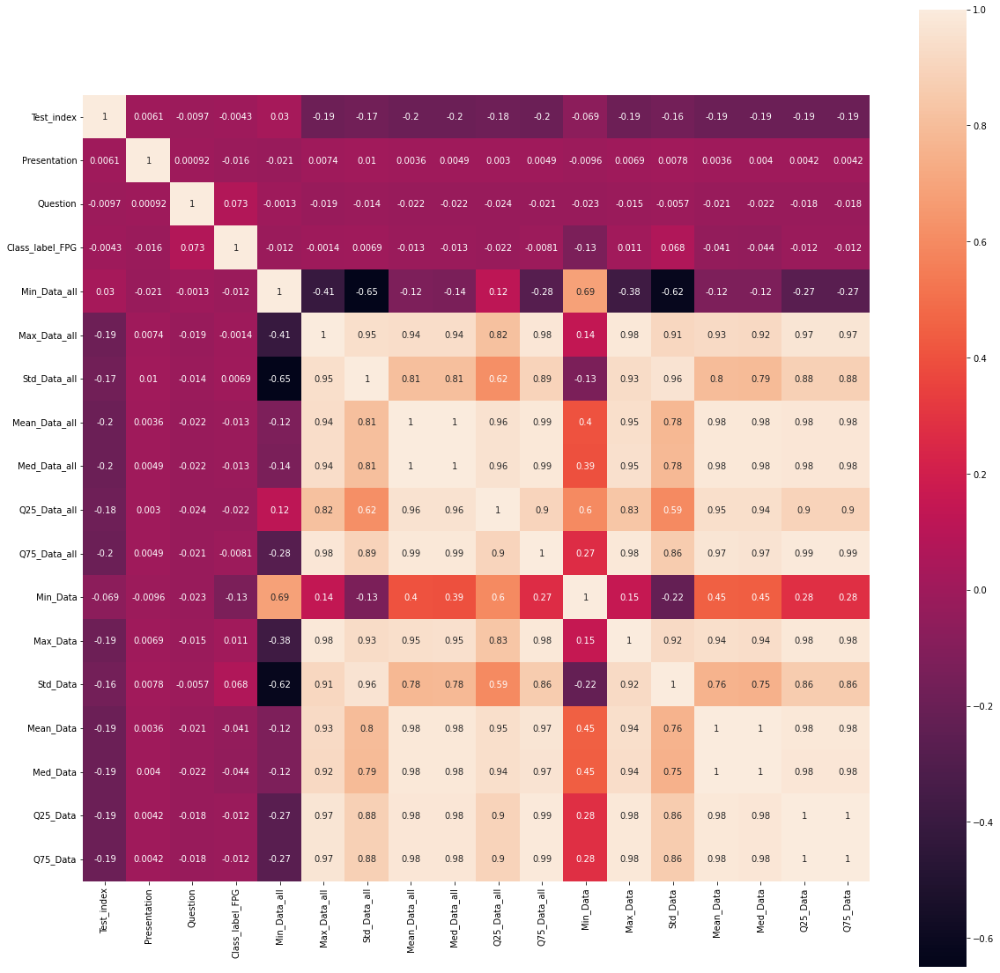

In [74]:
plt.rcParams['figure.figsize']=(20,20)
g = sns.heatmap(df_train_new.corr(), square = True, annot=True)

In [9]:
X = df_train_new.drop(['Obfuscated name','Test_index', 'Class_label_FPG', 'Data'], axis = 1)
y = df_train_new['Class_label_FPG']

In [142]:
colours = ['green','red','blue']
colour_list = [colours[i] for i in y]
Columns  = X.columns.tolist()
n = len(Columns)
k = 1
plt.rcParams["figure.figsize"] = (150,150)
for i in Columns:
  for j in Columns:
    plt.subplot(n,n,k)
    k = k + 1
    plt.scatter(X[i], X[j], c = colour_list )
    plt.xlabel(j)
    plt.ylabel(i)
plt.show()

In [10]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28713 entries, 0 to 28712
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Presentation   28713 non-null  int64  
 1   Question       28713 non-null  int64  
 2   Min_Data_all   28713 non-null  float64
 3   Max_Data_all   28713 non-null  float64
 4   Std_Data_all   28713 non-null  float64
 5   Mean_Data_all  28713 non-null  float64
 6   Med_Data_all   28713 non-null  float64
 7   Q25_Data_all   28713 non-null  float64
 8   Q75_Data_all   28713 non-null  float64
 9   Min_Data       28713 non-null  int64  
 10  Max_Data       28713 non-null  int64  
 11  Std_Data       28713 non-null  float64
 12  Mean_Data      28713 non-null  float64
 13  Med_Data       28713 non-null  float64
 14  Q25_Data       28713 non-null  float64
 15  Q75_Data       28713 non-null  float64
dtypes: float64(12), int64(4)
memory usage: 3.5 MB


In [11]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [12]:
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test,train_size=0.5, random_state=42, stratify=y_test)

In [13]:
cat_features=[0,1]
train_dataset = Pool(data=X_train,
                     label=y_train,
                     cat_features=cat_features)
validate_dataset = Pool(data=X_val,
                    label=y_val,
                    cat_features=cat_features)
test_dataset = Pool(data=X_test,
                    label=y_test,
                    cat_features=cat_features)

In [14]:
y_train.value_counts()

1    11364
2     6614
0     4992
Name: Class_label_FPG, dtype: int64

In [15]:
print(11364/6614,11364/4992)

1.7181735712125794 2.2764423076923075


In [179]:
model = CatBoostClassifier(random_state = 42,
                           #iterations = 3000,
                           #depth = 6,
                           #l2_leaf_reg = 2,
                           #classes_count=3,
                           #nan_mode = min,
                           #custom_metric = 'Recall',
                           ignored_features=[1],
                           eval_metric='MultiClass',
                           #bootstrap_type ='MVS',
                           #grow_policy ='Lossguide', 
                           #learning_rate=0.01,
                           #class_weights = (0.9,1,0.9),
                           #boosting_type ='Plain', 
                           use_best_model=True,
                           loss_function='MultiClass')

In [180]:
model.fit(train_dataset,eval_set=validate_dataset)

Learning rate set to 0.114961
0:	learn: 1.0779420	test: 1.0801171	best: 1.0801171 (0)	total: 49.4ms	remaining: 49.3s
1:	learn: 1.0614129	test: 1.0652696	best: 1.0652696 (1)	total: 95.3ms	remaining: 47.5s
2:	learn: 1.0485043	test: 1.0535730	best: 1.0535730 (2)	total: 140ms	remaining: 46.6s
3:	learn: 1.0365145	test: 1.0435398	best: 1.0435398 (3)	total: 185ms	remaining: 46s
4:	learn: 1.0285042	test: 1.0356837	best: 1.0356837 (4)	total: 238ms	remaining: 47.4s
5:	learn: 1.0205906	test: 1.0286160	best: 1.0286160 (5)	total: 285ms	remaining: 47.2s
6:	learn: 1.0132718	test: 1.0219147	best: 1.0219147 (6)	total: 333ms	remaining: 47.2s
7:	learn: 1.0074876	test: 1.0171193	best: 1.0171193 (7)	total: 378ms	remaining: 46.8s
8:	learn: 1.0003773	test: 1.0104650	best: 1.0104650 (8)	total: 422ms	remaining: 46.5s
9:	learn: 0.9951491	test: 1.0060712	best: 1.0060712 (9)	total: 477ms	remaining: 47.2s
10:	learn: 0.9899871	test: 1.0015347	best: 1.0015347 (10)	total: 523ms	remaining: 47s
11:	learn: 0.9855983	tes

In [181]:
#model.plot_tree(tree_idx = 0, pool=None)

In [182]:
pred = model.predict(test_dataset)

In [183]:
p = []
for i in pred:
   p.append(i[0])

In [184]:
print("Recall score:", recall_score(y_test, pred, average='macro'))

Recall score: 0.5134623863646123


In [185]:
print("Accuracy score:", accuracy_score(y_test, pred))

Accuracy score: 0.5956112852664577


In [186]:
Max_Error = 0
for i in y_test:
  if (i == 0):
    i = 2
  Max_Error+=i

In [187]:
print('catboost score:',1 - (np.abs(np.array(p)-np.array(y_test)).sum() / Max_Error))

catboost score: 0.7209625173530773


----------------------------

In [712]:
Data = {'Obfuscated name/Test_index/Presentation': [], 'Question': [], 'Data': [], 'Data_dlen':[], 'Class_label_FPG': [], 'Class_label_FPG_dlen': []}
df_Data = pd.DataFrame(Data)

In [713]:
Z = [10000 for i in range(240)]

In [714]:
Z1 = {'a':[]}
Z1 = pd.DataFrame()

In [715]:
Z1 = Z1.append({'a': Z}, ignore_index=True)

In [716]:
Z = Z1.to_numpy()

In [717]:
df_Data

,Obfuscated name/Test_index/Presentation,Question,Data,Data_dlen,Class_label_FPG,Class_label_FPG_dlen


In [718]:

for name in set(df_train['Obfuscated name'].tolist()):
  for test in set(df_train[df_train['Obfuscated name'] == name]['Test_index'].tolist()):
    for pres in set(df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test]['Presentation'].tolist()):
      Q = df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres]['Question'].to_numpy()
      D = df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres]['Data'].to_numpy()
      Dnl = D
      k = 0
      while(len(D)<14):
        Z1 = {'a':[]}
        Z1 = pd.DataFrame()
        if (len (D) != 1):
          Z1 = Z1.append({'a': D[k]}, ignore_index=True)
          Z = Z1.to_numpy()
          D = np.append(D,Z)
          k+=1
        else:
          Z1 = Z1.append({'a': D}, ignore_index=True)
          Z = Z1.to_numpy()
          D = np.append(D,Z)
      C = df_train[df_train['Obfuscated name'] == name][df_train['Test_index'] == test][df_train['Presentation'] == pres]['Class_label_FPG'].to_numpy()
      k = 0
      Cnl = C
      while(len(C)<14):
        C = np.append(C,C[k])
        k+=1
      df_Data = df_Data.append({'Obfuscated name/Test_index/Presentation': [name,test,pres], 'Question': Q, 'Data': D, 'Data_dlen': Dnl,'Class_label_FPG':C, 'Class_label_FPG_dlen':Cnl}, ignore_index=True)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [719]:
df_Data

,Obfuscated name/Test_index/Presentation,Question,Data,Data_dlen,Class_label_FPG,Class_label_FPG_dlen
0,"[4576fa68-dd00-4e2b-bb70-c1e54b6f9199, 1, 1]","[7, 1, 2, 12, 4, 11, 5, 10, 6, 9, 3]","[[6, -9, 3, 43, 80, 86, 83, 74, 67, 62, 56, 45...","[[6, -9, 3, 43, 80, 86, 83, 74, 67, 62, 56, 45...","[1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 2, 1, 1, 1]","[1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 2]"
1,"[4576fa68-dd00-4e2b-bb70-c1e54b6f9199, 1, 2]","[6, 9, 1, 2, 4, 3, 12, 8, 7]","[[-97, -105, -112, -116, -106, -75, -60, -65, ...","[[-97, -105, -112, -116, -106, -75, -60, -65, ...","[0, 1, 2, 0, 0, 1, 2, 1, 1, 0, 1, 2, 0, 0]","[0, 1, 2, 0, 0, 1, 2, 1, 1]"
2,"[4576fa68-dd00-4e2b-bb70-c1e54b6f9199, 1, 3]","[9, 11, 8, 3, 2, 10, 7, 5, 6]","[[17, 11, 7, 22, 47, 53, 41, 27, 23, 19, 11, 1...","[[17, 11, 7, 22, 47, 53, 41, 27, 23, 19, 11, 1...","[1, 0, 1, 0, 1, 0, 1, 0, 2, 1, 0, 1, 0, 1]","[1, 0, 1, 0, 1, 0, 1, 0, 2]"
3,"[4576fa68-dd00-4e2b-bb70-c1e54b6f9199, 2, 1]","[7, 2, 6, 12, 3, 8, 10, 5]","[[36, 30, 22, 17, 24, 56, 69, 69, 60, 53, 48, ...","[[36, 30, 22, 17, 24, 56, 69, 69, 60, 53, 48, ...","[0, 2, 1, 1, 1, 0, 0, 2, 0, 2, 1, 1, 1, 0]","[0, 2, 1, 1, 1, 0, 0, 2]"
4,"[4576fa68-dd00-4e2b-bb70-c1e54b6f9199, 2, 2]","[7, 9, 10, 12, 5, 8, 1, 4, 11, 2, 3, 6]","[[22, 43, 46, 40, 31, 24, 19, 11, -3, -13, -19...","[[22, 43, 46, 40, 31, 24, 19, 11, -3, -13, -19...","[1, 1, 0, 1, 2, 1, 0, 1, 1, 2, 0, 0, 1, 1]","[1, 1, 0, 1, 2, 1, 0, 1, 1, 2, 0, 0]"
...,...,...,...,...,...,...
2922,"[60036579-ffae-4715-9248-a576774a5ee3, 2, 2]","[1, 6, 7, 11, 9, 4, 3, 2, 8, 10, 12, 5]","[[-213, -85, 55, 164, 223, 214, 162, 113, 54, ...","[[-213, -85, 55, 164, 223, 214, 162, 113, 54, ...","[0, 1, 2, 1, 2, 1, 1, 2, 1, 1, 1, 0, 0, 1]","[0, 1, 2, 1, 2, 1, 1, 2, 1, 1, 1, 0]"
2923,"[60036579-ffae-4715-9248-a576774a5ee3, 2, 3]","[1, 8, 6, 10, 5, 9, 7, 12, 11]","[[-53, -77, -126, -184, -213, -254, -284, -292...","[[-53, -77, -126, -184, -213, -254, -284, -292...","[1, 1, 2, 1, 1, 2, 2, 2, 1, 1, 1, 2, 1, 1]","[1, 1, 2, 1, 1, 2, 2, 2, 1]"
2924,"[60036579-ffae-4715-9248-a576774a5ee3, 3, 1]","[5, 12, 10, 2, 7, 8, 11, 4, 3, 6]","[[-58, 5, 83, 122, 136, 112, 97, 83, 67, 43, 2...","[[-58, 5, 83, 122, 136, 112, 97, 83, 67, 43, 2...","[1, 1, 1, 2, 1, 2, 1, 0, 1, 2, 1, 1, 1, 2]","[1, 1, 1, 2, 1, 2, 1, 0, 1, 2]"
2925,"[60036579-ffae-4715-9248-a576774a5ee3, 3, 2]","[8, 5, 9, 2, 7, 3, 4, 6, 12]","[[120, 87, 46, 0, -45, -108, -159, -134, -12, ...","[[120, 87, 46, 0, -45, -108, -159, -134, -12, ...","[2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 1]","[2, 1, 1, 2, 1, 1, 2, 1, 2]"


In [628]:
Xn = df_Data['Data_dlen']
yn = df_Data['Class_label_FPG_dlen']

In [641]:
Xn_kv = []
for i in Xn:
  t = np.array(list(i))
  t = t.reshape(1,t.shape[0]*t.shape[1])
  Xn_kv.append([np.quantile(t,0.01), np.quantile(t,0.99)])

In [642]:
len(Xn_kv)

2927

In [643]:
len(Xn.to_numpy())

2927

In [720]:

q1 = 0.99
q2 =0.75
Xn_kv = []
for i in Xn:
      t = np.array(list(i))
      t = t.reshape(1,t.shape[0]*t.shape[1])
      Xn_kv.append([np.quantile(t,1-q1), np.quantile(t,q1)])
    
Pn = []
k = 0
for i in Xn.to_numpy():
      p = []
      for j in i:
        flag = 0
        a = 1
        if (np.quantile(np.array(j),1-q2) < Xn_kv[k][0]):
          a = 0
          flag+=1
        if (np.quantile(np.array(j),q2) > Xn_kv[k][1]):
          a = 2
          flag+=1
        if(flag!=1):
          a = 1
        p.append(a)
      k+=1
      Pn.append(p)
    
Max_P = 0
for p in Pn:
      for j in p:
        if(j == 0):
          j = 2
        Max_P +=j 
    
P = np.array(Pn) - np.array(yn)
P = np.abs(P)
Sum = 0
for p in P:
      Sum += p.sum()



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


In [721]:
print('Score:', 1 - Sum/Max_P)

Score: 0.494723644342284


In [395]:
X = df_Data['Data']
y = df_Data['Class_label_FPG']
X_train, X_test, y_train, y_test = train_test_split(X, y,train_size=0.8, random_state=42)
#X_test, X_val, y_test, y_val = train_test_split(X_test, y_test,train_size=0.5, random_state=42)

In [396]:
y_test_s = []
for i in y_test:
  a = []
  for j in i:
    if(j != 3):
      a.append(j)
  y_test_s.append(a)
'''
y_train_s = []
for i in y_train:
  y_train_s.append(i)

y_train_np_s = np.array(y_train_s)
y_test_np_s = np.array(y_test_s)
'''

'\ny_train_s = []\nfor i in y_train:\n  y_train_s.append(i)\n\ny_train_np_s = np.array(y_train_s)\ny_test_np_s = np.array(y_test_s)\n'

In [397]:
'''
y_test_h = []
for i in y_test:
  b = []
  for j in i:
    a = [0,0,0,0]
    a[j] = 1
    b.append(a)
  y_test_h.append(b)
'''
y_train_h = []

for i in y_train:
  b = []
  for j in i:
    a = [0,0,0]
    a[j] = 1
    b.append(a)
  y_train_h.append(b)

In [398]:
y_train_np_h = np.array(y_train_h)
#y_test_np_h = np.array(y_test_h)

In [399]:
np.shape(X_train_np) 

(2341,)

In [403]:
X_train_np = []
for i in X_train.to_numpy():
  b = []
  for j in i:
    b.append(j)
  X_train_np.append(b)
X_train_np  = np.array(X_train_np)
X_train_np = X_train_np.reshape(X_train_np.shape[0],240,14)

X_test_np = []
for i in X_test.to_numpy():
  b = []
  for j in i:
    b.append(j)
  X_test_np.append(b)
X_test_np  = np.array(X_test_np)
X_test_np = X_test_np.reshape(X_test_np.shape[0],240,14)

print(np.shape(X_train_np))
print(np.shape(X_test_np))

(2341, 240, 14)
(586, 240, 14)


In [450]:
np.shape(y_train_np_h)

(2341, 14, 3)

In [441]:
model = Sequential()

#model.add(LSTM(50, activation='softmax', input_shape=(240, 1)))
#model.add(LSTM(100, activation='softmax', dropout = 0.1, input_shape=(240, 1)))
#model.add(tf.keras.layers.Masking(mask_value=10000,input_shape=(240, 14)))

#model.add(Bidirectional(LSTM(70, activation='softmax', return_sequences=True, dropout = 0.2), input_shape=(240, 14)))
#model.add(Bidirectional(LSTM(50, activation='softmax', return_sequences=True), input_shape=(240, 14)))
#model.add(Bidirectional(LSTM(50, activation='softmax', return_sequences=True), input_shape=(240, 14)))
#model.add(Bidirectional(LSTM(50, activation='softmax'), input_shape=(240, 14)))
#model.add(MaxPooling1D(pool_size=2))
#model.add(LSTM(32, activation='softmax',input_shape=(120, 14)))
model.add(LSTM(100, activation='softmax', return_sequences=True,input_shape=(240, 14)))
model.add(LSTM(100, activation='softmax', return_sequences=True,input_shape=(240, 14)))
model.add(LSTM(100, activation='softmax',input_shape=(240, 14)))
model.add(Dense(42))
model.add(Reshape((14, 3), input_shape=(42,)))
model.add(keras.layers.LeakyReLU(alpha=0.3))
model.add(Activation('softmax'))

In [442]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
model.fit(X_train_np, y_train_np_h,
            batch_size = 64,
            epochs = 5,
            validation_split = 0.3,
            verbose = 1)

In [423]:
scores = model.predict(X_test_np)

19/19 [==============================] - 9s 440ms/step


In [424]:
scores

array([[[0.28474012, 0.3947985 , 0.32046133],
        [0.29011795, 0.40160474, 0.30827722],
        [0.28460607, 0.40212703, 0.31326693],
        ...,
        [0.28997794, 0.3962266 , 0.3137953 ],
        [0.29160255, 0.39972165, 0.3086757 ],
        [0.29365802, 0.4058735 , 0.30046847]],

       [[0.2847401 , 0.39479855, 0.32046136],
        [0.29011798, 0.40160486, 0.30827722],
        [0.284606  , 0.40212703, 0.3132669 ],
        ...,
        [0.28997797, 0.3962267 , 0.31379527],
        [0.29160255, 0.3997217 , 0.30867574],
        [0.293658  , 0.40587354, 0.30046842]],

       [[0.28474012, 0.39479855, 0.32046136],
        [0.29011795, 0.4016048 , 0.30827722],
        [0.284606  , 0.40212703, 0.3132669 ],
        ...,
        [0.28997797, 0.3962267 , 0.31379533],
        [0.29160255, 0.3997217 , 0.3086757 ],
        [0.293658  , 0.40587354, 0.30046844]],

       ...,

       [[0.28474015, 0.39479855, 0.32046136],
        [0.29011798, 0.4016048 , 0.30827722],
        [0.28460607, 0

In [425]:
scores_ = np.argmax(scores,axis =2)

In [426]:
P = []
Max_P = 0
i = 0
for s in scores_:
  P.append([x - y for x, y in zip(y_test_s[i], s)])
  for j in s:
    if(j == 0):
      j = 2
    Max_P +=j 
  i+=1
P = np.abs(np.array(P))
P = P.sum()


In [427]:
print('Score:', 1 - P/Max_P)

Score: 0.49024865919063876


----------------


In [ ]:
#df_train_new = df_train[['Data','Class_label_FPG']]

In [ ]:
#df_train_new.head()

,Data,Class_label_FPG
0,-24 51 75 51 14 -13 -25 -45 -77 -76 -18 84 146...,1
1,-305 -320 -278 -267 -308 -375 -467 -531 -439 -...,1
2,60 37 39 69 60 30 -7 -37 -60 -71 -87 -100 -123...,1
3,65 48 30 18 9 0 -18 -35 -1 83 119 121 111 108 ...,1
4,116 95 80 78 78 73 63 47 45 94 119 105 87 74 7...,1


In [ ]:
#X = df_train_new['Data']
#y = df_train_new['Class_label_FPG']

In [ ]:
#X_train, X_test, y_train, y_test = train_test_split(X, y,train_size=0.6, random_state=42, stratify=y)
#X_test, X_val, y_test, y_val = train_test_split(X_test, y_test,train_size=0.5, random_state=42, stratify=y_test)

In [ ]:
'''
y_test_h = []
for i in y_test:
  a = [0,0,0]
  a[i] = 1
  y_test_h.append(a)

y_train_h = []
for i in y_train:
  a = [0,0,0]
  a[i] = 1
  y_train_h.append(a)

y_val_h = []
for i in y_val:
  a = [0,0,0]
  a[i] = 1
  y_val_h.append(a)
'''


In [ ]:
'''
y_train_np_h = np.array(y_train_h)
y_test_np_h = np.array(y_test_h)
y_val_np_h = np.array(y_val_h)
'''

In [ ]:
'''
y_train_np = y_train.to_numpy()
y_test_np = y_test.to_numpy()
y_val_np = y_val.to_numpy()
X_train_np = np.array(X_train)
X_test_np = np.array(X_test)
X_val_np = np.array(X_val)
'''

In [ ]:
#y_val_np_h

array([[0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       ...,
       [0, 0, 1],
       [0, 1, 0],
       [0, 0, 1]])

In [ ]:
'''
X_train_r = X_train_np.reshape((X_train_np.shape[0], X_train_np.shape[1], 1))
X_test_r = X_test_np.reshape((X_test_np.shape[0], X_test_np.shape[1], 1))
X_val_r = X_val_np.reshape((X_val_np.shape[0], X_val_np.shape[1], 1))
'''

In [ ]:
'''
model = Sequential()

#model.add(LSTM(50, activation='softmax', input_shape=(240, 1)))
#model.add(LSTM(100, activation='softmax', dropout = 0.1, input_shape=(240, 1)))


#model.add(Bidirectional(LSTM(70, activation='softmax', return_sequences=True, dropout = 0.2), input_shape=(240, 1)))
model.add(Bidirectional(LSTM(120, activation='softmax'), input_shape=(240, 1)))
#model.add(MaxPooling1D(pool_size=2))
#model.add(LSTM(32, activation='softmax',input_shape=(120, 1)))
#model.add(LSTM(32, activation='softmax', return_sequences=True,stateful=True, dropout=0.2, recurrent_dropout=0.2,))



model.add(Dense(3, activation='softmax'))
'''
 

In [ ]:
# Компилируем модель нейронной сети
#model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
#model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])


In [ ]:
'''
model.fit(X_train_r, y_train_np_h,
           batch_size = 64,
           epochs = 1,
           validation_data = (X_val_r, y_val_np_h),
           verbose = 1)
'''

In [ ]:
#scores = model.predict(X_test_r)

180/180 [==============================] - 6s 34ms/step


In [ ]:
 #scores1 = model.evaluate(X_test_r, y_test_np_h, batch_size = 64)
 #print('Точность на тестовых данных: %.2f%%' % (scores1[1] * 100))

90/90 [==============================] - 3s 33ms/step - loss: 1.0353 - accuracy: 0.4947
Точность на тестовых данных: 49.47%


In [ ]:
#scores

array([[0.2161297 , 0.48159334, 0.30227694],
       [0.21510209, 0.48372895, 0.30116892],
       [0.2695283 , 0.47524366, 0.25522813],
       ...,
       [0.26257053, 0.4726475 , 0.264782  ],
       [0.14969073, 0.50635815, 0.34395114],
       [0.11793107, 0.448705  , 0.433364  ]], dtype=float32)

In [ ]:
#p = np.argmax(scores, axis = 1)

In [ ]:
#np.abs(p - y_test_np).sum()

2902

In [ ]:
#print("Recall score:", recall_score(y_test, p, average='macro'))

Recall score: 0.3333333333333333
